This notebook is an unsuccessful attempt at training a multimodal GAN. The model's results appear the same as noise, which reflects that the model was ill-defined, and so we don't discuss this model in our paper. This notebook is only here to show the attempt, and I realize that this reflects poorly on my competence.

# Download data and import modules

In [1]:
!pip install pytorch-lightning --quiet
import pytorch_lightning as pl

     |████████████████████████████████| 563kB 7.9MB/s 
     |████████████████████████████████| 829kB 31.1MB/s 
     |████████████████████████████████| 92kB 12.8MB/s 
     |████████████████████████████████| 276kB 42.8MB/s 


In [2]:
device = 'cuda'

In [3]:
!rm -r '/content/sample_data'
!pip install -q kaggle
from google.colab import drive
drive.mount('/content/drive')
# Get Kaggle Token by uploading to your drive
!cp '/content/drive/My Drive/kaggle.json' kaggle.json
# Move the Token to .kaggle so Colab can use it
!mkdir /root/.kaggle
!cp kaggle.json /root/.kaggle/
!chmod 600 /root/.kaggle/kaggle.json

# Download Datasets and move them to /train folder. Processed one at a time due to storage limitations
!kaggle competitions download -c 'painter-by-numbers' -f 'train_info.csv'
!unzip -q train_info.csv.zip -d train
!rm train_info.csv.zip

!kaggle competitions download -c 'painter-by-numbers' -f 'train_1.zip'
!unzip -q train_1.zip -d train
!mv train/train_1/* train/
!rm train_1.zip

# !kaggle competitions download -c 'painter-by-numbers' -f 'train_2.zip'
# !unzip -q train_2.zip -d train
# !mv train/train_2/* train/
# !rm train_2.zip

# !kaggle competitions download -c 'painter-by-numbers' -f 'train_3.zip'
# !unzip -q train_3.zip -d train
# !mv train/train_3/* train/
# !rm train_3.zip

# !kaggle competitions download -c 'painter-by-numbers' -f 'train_4.zip'
# !unzip -q train_4.zip -d train
# !mv train/train_4/* train/
# !rm train_4.zip

# !kaggle competitions download -c 'painter-by-numbers' -f 'train_5.zip'
# !unzip -q train_5.zip -d train
# !mv train/train_5/* train/
# !rm train_5.zip

# !kaggle competitions download -c 'painter-by-numbers' -f 'train_6.zip'
# !unzip -q train_6.zip -d train
# !mv train/train_6/* train/
# !rm train_6.zip

# !kaggle competitions download -c 'painter-by-numbers' -f 'train_6.zip'
# !unzip -q train_7.zip -d train
# !mv train/train_7/* train/
# !rm train_7.zip

Mounted at /content/drive
  0% 0.00/2.46M [00:00<?, ?B/s]
100% 2.46M/2.46M [00:00<00:00, 83.0MB/s]
100% 4.74G/4.76G [01:39<00:00, 45.5MB/s]
100% 4.76G/4.76G [01:39<00:00, 51.4MB/s]


In [4]:
import pandas as pd
import torch, os
import numpy as np
import torchvision 
from torchvision.utils import save_image
import torchvision.transforms as transforms
import torchvision.transforms.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
from PIL import Image
from os import listdir
from PIL import ImageFile

# This was added while trying to fix an error. Need to test if its still needed
ImageFile.LOAD_TRUNCATED_IMAGES = True
Image.MAX_IMAGE_PIXELS = None

# Load dataset and visualize

In [8]:
class KaggleDataset(torch.utils.data.Dataset):
  def __init__(self, vocab, max_length=100, folder = 'train', image_transform = None):
    self.image_transform = image_transform
    self.folder = folder
    self.max_length = max_length
    # Load JSON files
    self.train_info = pd.read_csv('train/train_info.csv')

    ## This would work if we had all files, but not when we have partial
    # self.img_filename = np.array(self.train_info['filename'])
    # self.img_title = np.array(self.train_info['title'])

    # This would work if we had partial data. Would also work with all files, but would be inefficient
    available_files = {f for f in os.listdir(folder)}

    self.word2id = {w:i for i, w in enumerate(vocab)}
    self.word2id['<UNK>'] = len(vocab)
    self.word2id['<START>'] = len(vocab) + 1
    self.word2id['<END>'] = len(vocab) + 2
    self.word2id['<PAD>'] = len(vocab) + 3
    self.vocab_size = len(self.word2id)
    self.id2word = {i:w for (w, i) in self.word2id.items()}

    self.img_filenames = []
    self.tokenized_titles = []
    self.titles = []
    for idx, row in self.train_info.iterrows():
      if row['filename'].endswith(".jpg") and row['filename'] in available_files:
        self.img_filenames.append(row['filename'])
        title = str(row['title'])
        if title == '':
          title = 'untitled'
        self.titles.append(title)
        self.tokenized_titles.append(self.tokenize(title)[:])

  def __getitem__(self, index:int):
    # Load images on the fly.
    filename = self.img_filenames[index]
    img_path = os.path.join(self.folder, filename)

    with open(img_path, 'rb') as f:
        img = Image.open(f)
        image = img.convert('RGB')

    # image = Image.open(img_path)

    tokenized_title = self.tokenized_titles[index]
    title = self.titles[index]

    if self.image_transform: image = self.image_transform(image)

    return image, tokenized_title, title

  def __len__(self):
    return len(self.img_filenames)
  
  def tokenize(self, text):
    chars = list(text)
    encoded_text = [self.word2id.get(w, self.word2id['<UNK>']) for w in chars]
    encoded_text = encoded_text[:self.max_length-2]
    encoded_text_array = np.ones(self.max_length) * self.word2id['<PAD>']
    encoded_text_array[0] = self.word2id['<START>']
    encoded_text_array[1:len(encoded_text) + 1] = encoded_text
    encoded_text_array[len(encoded_text) + 1] = self.word2id['<END>']
    return torch.tensor(encoded_text_array, dtype = torch.long)
  
  def untokenize(self, token_ids):
    return ''.join([self.id2word[id] for id in token_ids.detach().numpy()])

max title length: 199
average title length: 22.717900620648848
unique characters: 346
84


{' ': 228701,
 '"': 1139,
 '#': 215,
 "'": 3319,
 '(': 4104,
 ')': 4081,
 ',': 7360,
 '-': 3095,
 '.': 6309,
 '0': 681,
 '1': 2192,
 '2': 983,
 '3': 732,
 '4': 609,
 '5': 645,
 '6': 580,
 '7': 833,
 '8': 684,
 '9': 768,
 ':': 551,
 'A': 12752,
 'B': 11714,
 'C': 15047,
 'D': 7503,
 'E': 5047,
 'F': 9090,
 'G': 7603,
 'H': 7292,
 'I': 7152,
 'J': 3248,
 'K': 2480,
 'L': 10696,
 'M': 13193,
 'N': 4922,
 'O': 3746,
 'P': 17221,
 'Q': 532,
 'R': 7729,
 'S': 22090,
 'T': 19200,
 'U': 3216,
 'V': 6033,
 'W': 7391,
 'X': 346,
 'Y': 1812,
 'Z': 471,
 '`': 156,
 'a': 130035,
 'b': 11729,
 'c': 28814,
 'd': 46118,
 'e': 163322,
 'f': 30106,
 'g': 27057,
 'h': 59317,
 'i': 109939,
 'j': 1090,
 'k': 12330,
 'l': 64181,
 'm': 27269,
 'n': 106866,
 'o': 110434,
 'p': 19832,
 'q': 1553,
 'r': 103224,
 's': 69645,
 't': 110448,
 'u': 39440,
 'v': 11290,
 'w': 15893,
 'x': 1986,
 'y': 18295,
 'z': 2751,
 '\xa0': 2473,
 'à': 120,
 'á': 139,
 'ç': 107,
 'è': 194,
 'é': 693,
 'í': 106,
 'ü': 119,
 'ă': 10

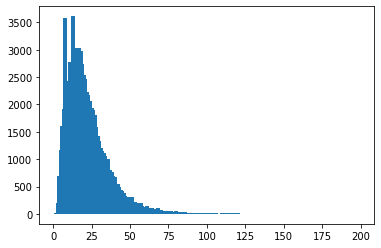

In [9]:
# Creating vocab list of chars
train_info = pd.read_csv('train/train_info.csv')

title_lengths = [len(str(x)) for x in train_info['title']]
values, counts = np.unique(title_lengths, return_counts=True)
plt.vlines(values, 0, counts, color='C0', lw=4)

print('max title length:', max(title_lengths))
print('average title length:', np.mean(title_lengths))

text_vocab = dict()
for title in train_info['title']:
  for ch in str(title):
    if ch not in text_vocab:
      text_vocab[ch] = 1
    else:
      text_vocab[ch] += 1
print('unique characters:', len(text_vocab))

# remove chars with less than 100 occurences
filtered = dict()
for key, value in text_vocab.items():
  if value >= 100:
    filtered[key] = value

print(len(filtered))
filtered

In [10]:
image_size = 64

transform = transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
                           ])
kaggleset = KaggleDataset(vocab=filtered, image_transform=transform)

img, tok, title = kaggleset[345]
print(kaggleset.untokenize(tok))
print(kaggleset.untokenize(kaggleset.tokenize(title)))

<START>Madonna and Child (Madonna Benson) <END><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD>
<START>Madonna and Child (Madonna Benson) <END><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD><PAD>


In [11]:
def tokens2sentences(max_tokens, start_included=False, max_length=100):
  if start_included:
    max_tokens = max_tokens[:,1:]
  max_words = np.vectorize(kaggleset.id2word.get)(max_tokens.cpu())
  sentences = []
  for max_word in max_words:
    limited_words = []
    for i,word in enumerate(max_word):
      if word == '<END>' or i == max_length:
        break
      limited_words.append(word)
    sentences.append(''.join(limited_words))
  return sentences
tokens2sentences(tok.unsqueeze(0), start_included=True)

['Madonna and Child (Madonna Benson) ']

In [12]:
# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 10

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 0

dataloader = torch.utils.data.DataLoader(kaggleset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# dataloader = torch.utils.data.DataLoader(met_trainset, batch_size=batch_size,
#                                          shuffle=True, num_workers=workers)


# Plot some training images
real_batch = next(iter(dataloader))

# https://stackoverflow.com/questions/46615554/how-to-display-multiple-images-in-one-figure-correctly/46616645
import numpy as np
import matplotlib.pyplot as plt
from textwrap import wrap

def show(imgs, labels=None, normalize=False, untokenize=False, start_included=False):
  imgs = imgs.cpu().detach().numpy()
  fig = plt.figure(figsize=(16, 16))
  columns = 4
  rows = 4
  max_examples = rows*columns

  if untokenize:
    labels = tokens2sentences(labels, start_included=start_included)

  if labels != None:
    # ax enables access to manipulate each of subplots
    ax = []
    
    for i, example in enumerate(zip(imgs, labels)):
      if i >= max_examples:
        break
      img, label = example
      
      img = np.transpose(img,(1,2,0))

      if normalize:
        img = torch.tensor(img)
        fmin = float(img.min())
        fmax = float(img.max())
        img.clamp_(min=fmin, max=fmax)
        img.add_(-fmin).div_(fmax - fmin + 1e-5)

      # create subplot and append to ax
      ax.append( fig.add_subplot(rows, columns, i+1) )
      ax[-1].set_title("\n".join(wrap(label, 30)))  # set title
      ax[-1].axis("off")
      img = np.clip(img, 0, 1)
      plt.imshow(img)

    plt.subplots_adjust(wspace=0, hspace=.25)
  
  else:
    ax = []
    
    for i, img in enumerate(imgs):
      if i >= max_examples:
        break
      img = np.transpose(img,(1,2,0))

      if normalize:
        img = torch.tensor(img)
        fmin = float(img.min())
        fmax = float(img.max())
        img.clamp_(min=fmin, max=fmax)
        img.add_(-fmin).div_(fmax - fmin + 1e-5)

      # create subplot and append to ax
      ax.append( fig.add_subplot(rows, columns, i+1) )
      ax[-1].axis("off")
      img = np.clip(img, 0, 1)
      plt.imshow(img)

    plt.subplots_adjust(wspace=0, hspace=.25)
  return fig

In [13]:
imgs, toks, texts = real_batch
imgs.shape, toks.shape, len(texts)

(torch.Size([64, 3, 64, 64]), torch.Size([64, 100]), 64)

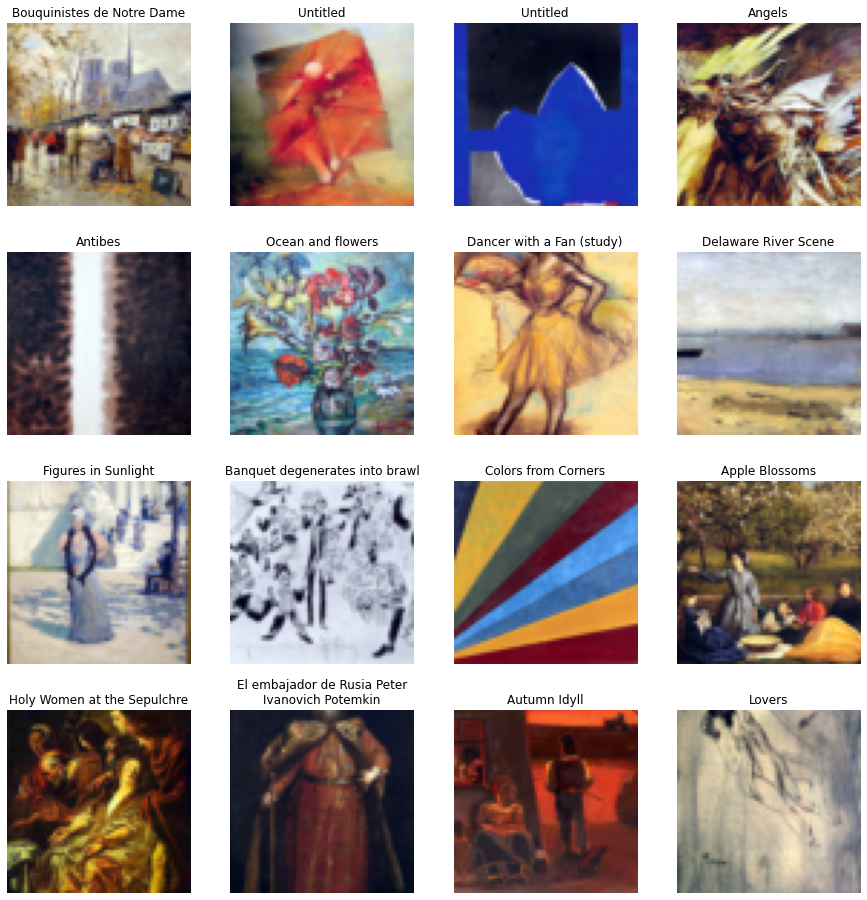

In [14]:
figure = show(imgs, toks, untokenize=True, start_included=True, normalize=True)

# Define model

In [15]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

torch.Size([64, 100, 1, 1])


(True, torch.Size([64, 3, 64, 64]))

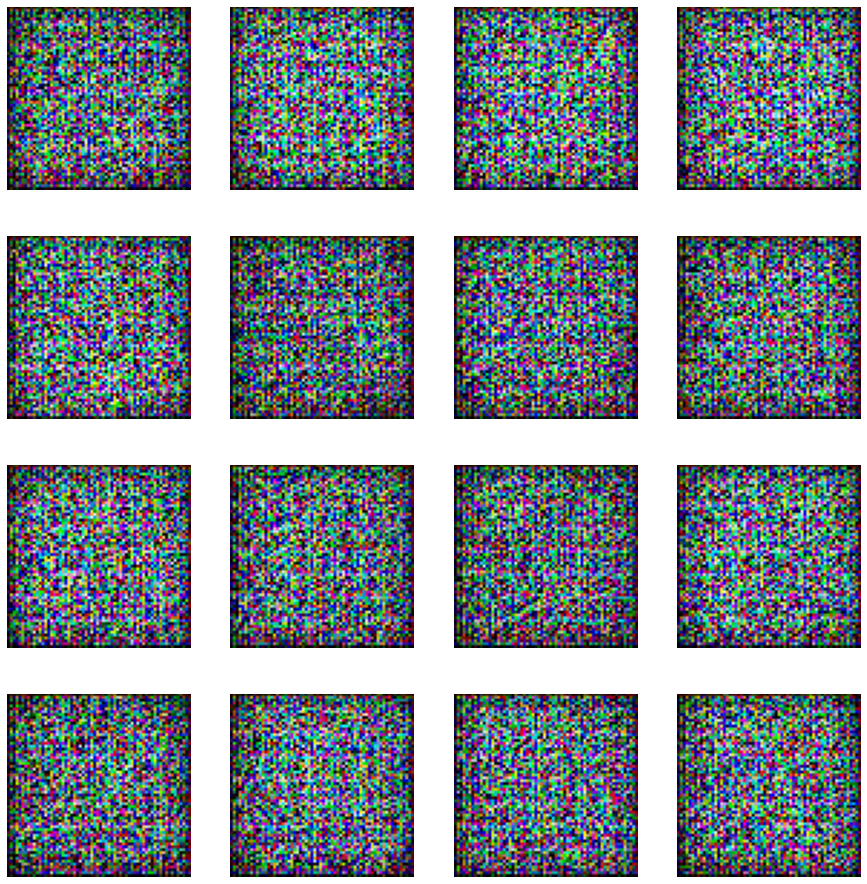

In [16]:
import torch.nn as nn
import torchvision.models as models

class ImageDecoder(nn.Module):
    def __init__(self, nz):
        super(ImageDecoder, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

imgdecoder = ImageDecoder(nz=nz).to(device)

noise = torch.randn(batch_size, nz, 1, 1, device=device)
print(noise.shape)
fake_img_batch = imgdecoder(noise)
show(fake_img_batch)
fake_img_batch.requires_grad, fake_img_batch.shape

In [17]:
import torch.nn as nn
from torch.nn import functional as Fnn

class TextDecoder(nn.Module):
    def __init__(self, state_size: int):
        super(TextDecoder, self).__init__()
        self.state_size = state_size
        self.vocab_size = kaggleset.vocab_size
        self.embedding = nn.Embedding(self.vocab_size, state_size)
        self.rnnCell = nn.LSTMCell(state_size, state_size, bias=True)
        self.predictionLayer = nn.Linear(state_size, self.vocab_size)
        self.init_weights()
        self.padding_token_id = kaggleset.word2id['<PAD>']
        
    def dummy_input_state(self, batch_size):
        return (torch.zeros(batch_size, self.state_size), torch.zeros(batch_size, self.state_size))
    
    def init_weights(self):
        self.embedding.weight.data.uniform_(-0.1, 0.1)
        self.predictionLayer.bias.data.fill_(0)
        self.predictionLayer.weight.data.uniform_(-0.1, 0.1)
        
    def forward(self, input_state, current_token_id):
        # Embed the input token id into a vector.
        embedded_token = self.embedding(current_token_id)

        # Pass the embedding through the RNN cell.
        h,c = self.rnnCell(embedded_token, input_state)
        
        # Output prediction.
        prediction = self.predictionLayer(Fnn.relu(h))
        
        return prediction, (h,c)
    
    def generate(self, input, max_length):
        lengths = torch.tensor([max_length])
        lengths = torch.unsqueeze(lengths,0)
        text=torch.tensor([[kaggleset.word2id["<START>"]]]*input.size(0)).to(device)

        predicted_scores = []
        
        start_token = text[:, 0]
        token_scores, state = self((input, input), start_token)
        predicted_scores.append(token_scores)

        # Iterate as much as the longest sequence in the batch.
        # minus 1 because we already fed the first token above.
        # minus 1 because we don't need to feed the end token <end>.
        for i in range(0, max(lengths) - 2):
            _, max_token = token_scores.max(dim = 1)
            current_token = max_token
            token_scores, state = textdecoder(state, current_token)
            predicted_scores.append(token_scores)
            
        # torch.stack(,1) forces batch_first = True on this output.
        scores = torch.stack(predicted_scores, 1)

        return scores


def scores2tokens(scores):
    # convert scores to sentences (but during training we can just keep the tokens)
    max_tokens = scores.max(dim = 2)[1]
    return max_tokens

batch_size = 32
max_length = 100
textdecoder = TextDecoder(state_size=nz).to(device)
noise = torch.randn(4, nz, device=device, requires_grad=True).to(device)
print(noise.requires_grad)

scores = textdecoder.generate(noise, max_length)
print(scores.requires_grad)
max_tokens = scores2tokens(scores)
tokens2sentences(max_tokens)

True
True


['-',
 '–2mmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmmm',
 '<UNK><UNK>áá<UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK>',
 '––áá<UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><UNK><U

torch.Size([3, 3, 64, 64]) torch.Size([3, 99, 88])


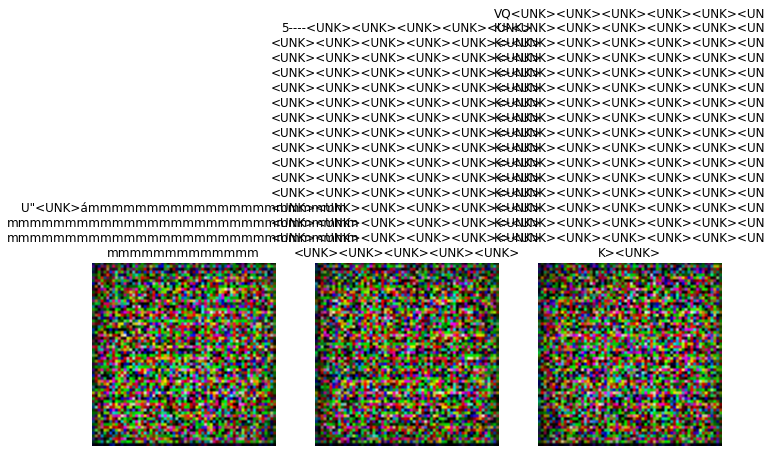

In [18]:
class Generator(nn.Module):
  def __init__(self, state_size: int, max_length=100):
    super(Generator, self).__init__()
    self.max_length = max_length
    self.imgdecoder = ImageDecoder(state_size).to(device)
    self.txtdecoder = TextDecoder(state_size).to(device)
  
  def forward(self, input):
    img = self.imgdecoder(input.unsqueeze(-1).unsqueeze(-1))
    text = self.txtdecoder.generate(input, self.max_length)
    return img, text
  
  def pretty_batch(self, input):
    img, text = self(input)
    tokens = scores2tokens(text)
    sentences = tokens2sentences(tokens)
    return img, tokens, sentences

batch_size = 32
max_length = 100
gen = Generator(state_size=nz, max_length=max_length)


noise = torch.randn(3, nz, device=device).to(device)
img, scores = gen(noise)
print(img.shape, scores.shape)
imgs, _, labels = gen.pretty_batch(noise)
fig = show(imgs, labels)

In [19]:
import torch.nn as nn
import torchvision.models as models

class ImageEncoder(nn.Module):
    # Encode images using Resnet-152
    def __init__(self, encoding_size: int):
        super(ImageEncoder, self).__init__()
        self.base_network = models.resnet152(pretrained = True)
        for param in self.base_network.parameters():
            param.requires_grad = False
        self.base_network.fc = nn.Linear(self.base_network.fc.in_features, encoding_size)
        self.bn = nn.BatchNorm1d(encoding_size, momentum=0.01)

        for param in self.base_network.fc.parameters():
            param.requires_grad = True
        
        for param in self.bn.parameters():
            param.requires_grad = True

        self.init_weights()
        self.dropout = nn.Dropout(p=0.3)

    def init_weights(self):
        
        self.base_network.fc.weight.data.normal_(0.0, 0.02)
        self.base_network.fc.bias.data.fill_(0)

    def forward(self, image):

        with torch.no_grad():

            x = self.base_network.conv1(image)
            x = self.base_network.bn1(x)
            x = self.base_network.relu(x)
            x = self.base_network.maxpool(x)
          
            x = self.dropout(self.base_network.layer1(x))
            x = self.dropout(self.base_network.layer2(x))
            x = self.dropout(self.base_network.layer3(x))
            x = self.dropout(self.base_network.layer4(x))
          
            x = self.base_network.avgpool(x)
            x = torch.flatten(x, 1)
  
        featureMap = self.base_network.fc(x)
        featureMap = self.bn(featureMap)
        return featureMap

imgencoder = ImageEncoder(encoding_size=64).to(device)
print(imgs.requires_grad)
encoded = imgencoder(img)
encoded.shape, encoded.requires_grad

Downloading: "https://download.pytorch.org/models/resnet152-b121ed2d.pth" to /root/.cache/torch/hub/checkpoints/resnet152-b121ed2d.pth



True


(torch.Size([3, 64]), True)

In [20]:
import torch.nn as nn
from torch.nn import functional as Fnn

class TextEncoder(nn.Module):
    def __init__(self, state_size: int, vocab_size: int, encoding_size: int):
        super(TextEncoder, self).__init__()
        self.state_size = state_size
        self.embedding = nn.Linear(vocab_size, state_size)
        self.rnnCell = nn.LSTMCell(state_size, state_size, bias=True)
        self.predictionLayer = nn.Linear(state_size, encoding_size)
        self.init_weights()
        self.end_token_id = kaggleset.word2id['<END>']
        
    def dummy_input_state(self, batch_size):
        return (torch.zeros(batch_size, self.state_size).to(device), torch.zeros(batch_size, self.state_size).to(device))
    
    def init_weights(self):
        self.embedding.weight.data.uniform_(-0.1, 0.1)
        self.predictionLayer.bias.data.fill_(0)
        self.predictionLayer.weight.data.uniform_(-0.1, 0.1)
        
    def forward(self, input_state, current_token_id):
        # Embed the input token id into a vector.
        embedded_token = self.embedding(current_token_id)
        
        # Pass the embedding through the RNN cell.
        h,c = self.rnnCell(embedded_token, input_state)
        
        # Output prediction.
        prediction = self.predictionLayer(Fnn.relu(h))
        
        return prediction, (h,c)
    
    def forwardline(self, text):
        lengths = []
        max_length = len(text[0])
        for line in text:
            length = max_length
            for i, token in enumerate(line):
                if torch.argmax(token).item() == self.end_token_id:
                  length = i
                  break
            lengths.append(length)

        hstate = self.dummy_input_state(text.size(0))

        for i in range(max(lengths)):
            prediction, hstate = self(hstate, text[:, i])
            
        # torch.stack(,1) forces batch_first = True on this output.
        return prediction

textencoder = TextEncoder(state_size=nz, vocab_size=kaggleset.vocab_size, encoding_size=64).to(device)

noise = torch.randn(3, nz, device=device).to(device)
imgs, scores = gen(noise)
print(imgs.requires_grad, imgs.shape)
print(scores.requires_grad, scores.shape)
pred = textencoder.forwardline(scores)
pred.shape, pred.requires_grad

True torch.Size([3, 3, 64, 64])
True torch.Size([3, 99, 88])


(torch.Size([3, 64]), True)

In [21]:
class Discriminator(nn.Module):
  def __init__(self, state_size: int, vocab_size, img_encoding_size, text_encoding_size):
    super(Discriminator, self).__init__()
    self.imgencoder = ImageEncoder(img_encoding_size)
    self.txtencoder = TextEncoder(state_size, vocab_size, text_encoding_size)
    self.bn = nn.BatchNorm1d(img_encoding_size+text_encoding_size, momentum=0.01)
    self.prediction = nn.Linear(img_encoding_size+text_encoding_size, 1)
    self.sigmoid = nn.Sigmoid()
    self.init_weights()
  
  def init_weights(self):
    self.prediction.weight.data.normal_(0.0, 0.02)
    self.prediction.bias.data.fill_(0)
  def forward(self, img, text):
    imgfeat = self.imgencoder(img)
    textfeat = self.txtencoder.forwardline(text)
    combined = torch.cat((imgfeat, textfeat), dim=1)
    pred = self.bn(combined)
    pred = self.prediction(pred)
    pred = self.sigmoid(pred)
    return pred

discr = Discriminator(state_size=nz, vocab_size=kaggleset.vocab_size, img_encoding_size=64, text_encoding_size=64).to(device)
imgs, scores = gen(noise)
pred = discr(imgs, scores)
pred.requires_grad

True

# Train model

In [25]:
# from pytorch-lightning tutorial on GANs https://colab.research.google.com/github/PytorchLightning/pytorch-lightning/blob/master/notebooks/03-basic-gan.ipynb#scrollTo=3vKszYf6y1Vv
from collections import OrderedDict

class MultimodalGAN(pl.LightningModule):
  def __init__(self, latent_dim, max_length, vocab_size,
               img_encoding_size, text_encoding_size,
                lr: float = 0.0002, b1: float = 0.5, b2: float = 0.999,):
    super().__init__()
    self.save_hyperparameters()
    self.generator = Generator(state_size=latent_dim, max_length=max_length).to(device)
    self.real_embedding = nn.Embedding(vocab_size, vocab_size).to(device)
    self.discriminator = Discriminator(state_size=latent_dim, vocab_size=vocab_size,
      img_encoding_size=img_encoding_size, text_encoding_size=text_encoding_size).to(device)
    self.validation_z = torch.randn(16, self.hparams.latent_dim).to(device)
    
  def forward(self, z):
    return self.generator(z)
  
  def adversarial_loss(self, y_hat, y):
    return Fnn.binary_cross_entropy(y_hat, y)

  def training_step(self, batch, batch_idx, optimizer_idx):
    imgs, toks, titles = batch
    
    z = torch.randn(imgs.size(0), self.hparams.latent_dim, requires_grad=True)
    z = z.type_as(imgs)

    # train generator
    if optimizer_idx == 0:

      # ground truth result (ie: all fake)
      # put on GPU because we created this tensor inside training_loop
      valid = torch.ones(imgs.size(0), 1)
      valid = valid.type_as(imgs)

      # adversarial loss is binary cross-entropy
      g_loss = self.adversarial_loss(self.discriminator(*self(z)), valid)
      tqdm_dict = {'g_loss': g_loss}
      output = OrderedDict({
          'loss': g_loss,
          'progress_bar': tqdm_dict,
          'log': tqdm_dict
      })
      return output
   
    # train discriminator
    if optimizer_idx == 1:
      # Measure discriminator's ability to classify real from generated samples

      # how well can it label as real?
      valid = torch.ones(imgs.size(0), 1)
      valid = valid.type_as(imgs)

      real_loss = self.adversarial_loss(self.discriminator(imgs, self.real_embedding(toks)), valid)

      # how well can it label as fake?
      fake = torch.zeros(imgs.size(0), 1)
      fake = fake.type_as(imgs)

      fake_imgs, fake_toks = self(z)
      fake_loss = self.adversarial_loss(
          self.discriminator(fake_imgs.detach(), fake_toks.detach()), fake)

      # discriminator loss is the average of these
      d_loss = (real_loss + fake_loss) / 2
      tqdm_dict = {'d_loss': d_loss}
      output = OrderedDict({
          'loss': d_loss,
          'progress_bar': tqdm_dict,
          'log': tqdm_dict
      })
      return output
  def configure_optimizers(self):
    lr = self.hparams.lr
    b1 = self.hparams.b1
    b2 = self.hparams.b2

    opt_g = torch.optim.Adam(self.generator.parameters(), lr=lr, betas=(b1, b2))
    opt_d = torch.optim.Adam(self.discriminator.parameters(), lr=lr, betas=(b1, b2))
    return [opt_g, opt_d], []

  def on_epoch_end(self):
    z = self.validation_z

    # generate images
    generated_imgs, generated_texts = self(z)
    generated_texts = scores2tokens(generated_texts)
    # log sampled images
    figure = show(generated_imgs[:16], generated_texts[:16], untokenize=True)
    self.logger.experiment.add_figure('generated_images_texts', figure, self.current_epoch)

In [26]:
nz = 100
max_length = 100
model = MultimodalGAN(latent_dim=nz, max_length=max_length, vocab_size=kaggleset.vocab_size,
  img_encoding_size=64, text_encoding_size=64)
model.to(device)
trainer = pl.Trainer(gpus=1, max_epochs=2, progress_bar_refresh_rate=20)
trainer.fit(model, train_dataloader=dataloader)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name           | Type          | Params
-------------------------------------------------
0 | generator      | Generator     | 3.7 M 
1 | real_embedding | Embedding     | 7.7 K 
2 | discriminator  | Discriminator | 58.4 M


/usr/local/lib/python3.6/dist-packages/pytorch_lightning/utilities/distributed.py:45: UserWarning: The {progress_bar:dict keyword} was deprecated in 0.9.1 and will be removed in 1.0.0
Please use self.log(...) inside the lightningModule instead.

# log on a step or aggregate epoch metric to the logger and/or progress bar
# (inside LightningModule)
self.log('train_loss', loss, on_step=True, on_epoch=True, prog_bar=True)
  warnings.warn(*args, **kwargs)
/usr/local/lib/python3.6/dist-packages/pytorch_lightning/utilities/distributed.py:45: UserWarning: The {log:dict keyword} was deprecated in 0.9.1 and will be removed in 1.0.0
Please use self.log(...) inside the lightningModule instead.

# log on a step or aggregate epoch metric to the logger and/or progress bar
# (inside LightningModule)
self.log('train_loss', loss, on_step=True, on_epoch=True, prog_bar=True)
  warnings.warn(*args, **kwargs)


1

In [28]:
trainer = pl.Trainer(gpus=1, max_epochs=40, progress_bar_refresh_rate=20)
trainer.fit(model, train_dataloader=dataloader)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name           | Type          | Params
-------------------------------------------------
0 | generator      | Generator     | 3.7 M 
1 | real_embedding | Embedding     | 7.7 K 
2 | discriminator  | Discriminator | 58.4 M


/usr/local/lib/python3.6/dist-packages/pytorch_lightning/utilities/distributed.py:45: UserWarning: The {progress_bar:dict keyword} was deprecated in 0.9.1 and will be removed in 1.0.0
Please use self.log(...) inside the lightningModule instead.

# log on a step or aggregate epoch metric to the logger and/or progress bar
# (inside LightningModule)
self.log('train_loss', loss, on_step=True, on_epoch=True, prog_bar=True)
  warnings.warn(*args, **kwargs)
/usr/local/lib/python3.6/dist-packages/pytorch_lightning/utilities/distributed.py:45: UserWarning: The {log:dict keyword} was deprecated in 0.9.1 and will be removed in 1.0.0
Please use self.log(...) inside the lightningModule instead.

# log on a step or aggregate epoch metric to the logger and/or progress bar
# (inside LightningModule)
self.log('train_loss', loss, on_step=True, on_epoch=True, prog_bar=True)
  warnings.warn(*args, **kwargs)


1

In [29]:
# Start tensorboard.
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 737), started 4:35:22 ago. (Use '!kill 737' to kill it.)

<IPython.core.display.Javascript object>

In [30]:
trainer.save_checkpoint("final.ckpt")

# Analysis

In [37]:
model.eval()
model.cuda()
noise = torch.randn(16, 100).cuda()
gen_imgs, gen_texts = model(noise)

In [38]:
gen_texts_text = scores2tokens(gen_texts)
gen_texts_text

tensor([[38,  1, 19,  ..., 84, 84, 84],
        [ 7, 85, 72,  ..., 14, 14, 14],
        [77, 84, 13,  ..., 14, 14, 14],
        ...,
        [85, 84, 84,  ..., 84, 84, 84],
        [77, 49, 11,  ..., 14, 14, 14],
        [77, 84, 84,  ..., 84, 84, 84]], device='cuda:0')

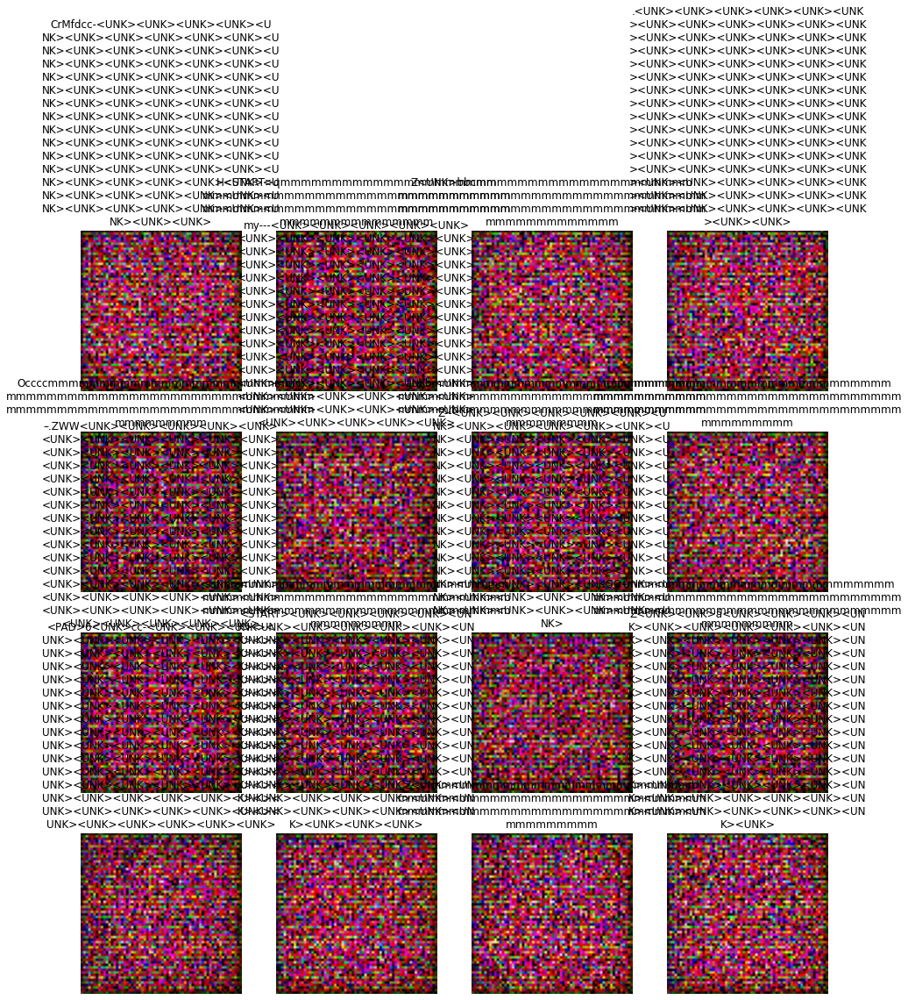

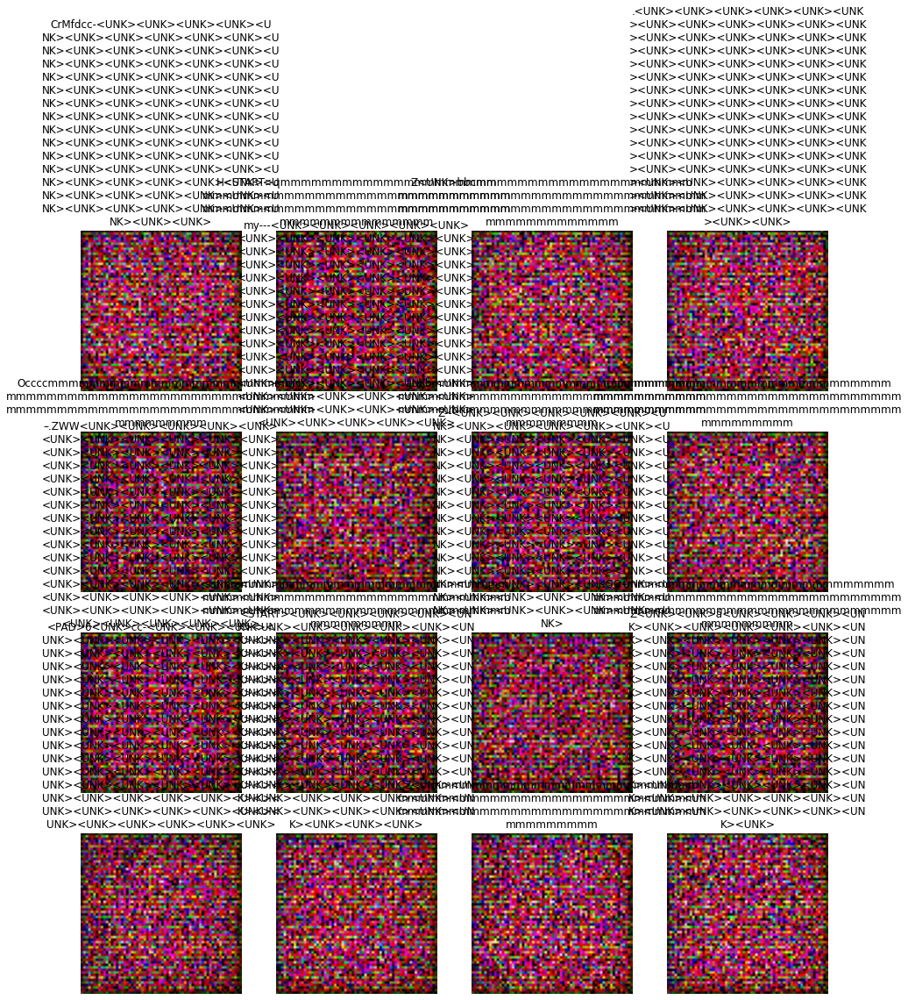

In [39]:
show(gen_imgs, gen_texts_text, untokenize=True)

Results look no better than noise, suggests that the model architecture was ill-defined.